# Bitcoin Prediction using Deep Learning

This time, you will build a basic Neural Network model to predict Bitcoin price based on historical Data.
This notebook helps you to train a model but you can use it however you want.

In [ ]:
from google.colab import drive
import os
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
os.getcwd()

'/content'

In [ ]:
os.chdir("/content/drive/MyDrive/EI time series")

In [ ]:
import numpy as np
import pandas as pd

from matplotlib import pyplot as plt
from tensorflow import keras
from tensorflow.keras import layers

from sklearn.preprocessing import MinMaxScaler

import helper_functions as hf

CURDIR = os.getcwd()
DATADIR = os.path.join(CURDIR,  "data")
FIGDIR = os.path.join(CURDIR,  "figure")
%matplotlib inline

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


# Import Data
Our Data come from https://blockchain.info/.

Here, we load data into a Pandas DataFrame

In [ ]:
df = pd.read_csv(os.path.join(DATADIR, "df_blockchain.csv"), 
                            delimiter=",")

In [ ]:
df.shape#seems like we dropped 11 rows

(3533, 23)

In [ ]:
!pip3 install pandas_profiling 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip3 install pandas_profiling --upgrade

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip3 install markupsafe==2.1.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip3 install MarkupSafe==2.0.1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached MarkupSafe-2.0.1-cp37-cp37m-manylinux_2_5_x86_64.manylinux1_x86_64.manylinux_2_12_x86_64.manylinux2010_x86_64.whl (31 kB)
  Attempting uninstall: MarkupSafe
    Found existing installation: MarkupSafe 2.1.1
    Uninstalling MarkupSafe-2.1.1:
      Successfully uninstalled MarkupSafe-2.1.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
pandas-profiling 3.2.0 requires markupsafe~=2.1.1, but you have markupsafe 2.0.1 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.


# Explore Dataset

We already explored dataset before, but you can draw other plots to analyse data if you want.

Idea : you can use pandas_profiling 

```python
from pandas_profiling import ProfileReport
ProfileReport(df)
```

In [ ]:
from pandas_profiling import ProfileReport

In [ ]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [15]:
df=df.dropna()#removing rows containing NaN

In [47]:
# let's test both extremes
#by putting all columns we get 19000 rmse
#by putting only market price and another correlated feature we get around 2000 rmse
columns=['market-price','market-cap']
dataset = df[columns]

In [48]:
dataset

,market-price,market-cap
0,6.88,5.022014e+07
1,6.19,4.540930e+07
2,5.92,4.322228e+07
3,5.58,4.088136e+07
4,5.18,3.801833e+07
...,...,...
3538,40784.32,7.379873e+11
3539,37280.35,6.998509e+11
3540,37528.30,6.642670e+11
3541,34754.54,6.847955e+11


# Data scaling

Here we scale the price between 0 and 1, this will help the optimization algorithm converge faster.

In [49]:
scaler = MinMaxScaler(feature_range=(0, 1))
dataset = scaler.fit_transform(dataset.values.reshape(-1,len(columns)))

In [ ]:
dataset.shape

In [ ]:
dataset

In [ ]:
plt.plot(dataset[:,0])

# Process data (Making sequences)

here we split and process data before training.

LSTM layer as an input layer expects the data to be 3 dimensions, we will use 'process_data' function to split data into sequences of a fixed length (rnn_size).

The neural network is expecting to have an input's shap of [batch_size, rnn_size, nb_features]

In [51]:
# split datatest into data_train, data_valid and data_test
data_train = dataset[:2650]#75%
data_valid = dataset[2650:3200]#15%
data_test = dataset[3200:]#10%

In [52]:
def process_data(data, rnn_size=3, target_id=0, columns_size=len(columns)):
    X = []
    y = []
    for i in range(len(data)-rnn_size):
        X.append(data[i:i+rnn_size,:])
        y.append(data[i+rnn_size,0])
    return np.array(X).astype(np.float32).reshape((-1,rnn_size,columns_size)), np.array(y).astype(np.float32)

In [53]:
# process data for RNN
X_train, y_train = process_data(data_train)
X_val, y_val = process_data(data_valid)
X_test, y_test = process_data(data_test)

In [ ]:
y_train.shape,X_train.shape

((2647,), (2647, 3, 2))

# Deep Learning Model

Here we initialize the model using Keras.

Here we propose to code a basic neural network LSTM + Dense, but you are free to use any architecture.

In [22]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, LSTM
import tensorflow as tf
rnn_size=3

In [23]:
regressor = keras.Sequential()
regressor.add(LSTM(128, input_shape=(rnn_size,len(columns)), 
                   activation='relu', return_sequences=True))
regressor.add(Dropout(0.2))

regressor.add(LSTM(64, activation='relu'))
regressor.add(Dropout(0.2))


regressor.add(Dense(32, activation='relu'))
regressor.add(Dropout(0.2))

regressor.add(Dense(1, activation='relu'))
opt = tf.keras.optimizers.Adam()
regressor.compile(optimizer='adam',
loss='mean_squared_error',metrics=['mean_squared_error'])

In [24]:
regressor.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 3, 128)            67072     
                                                                 
 dropout (Dropout)           (None, 3, 128)            0         
                                                                 
 lstm_1 (LSTM)               (None, 64)                49408     
                                                                 
 dropout_1 (Dropout)         (None, 64)                0         
                                                                 
 dense (Dense)               (None, 32)                2080      
                                                                 
 dropout_2 (Dropout)         (None, 32)                0         
                                                                 
 dense_1 (Dense)             (None, 1)                 3

In [25]:
history=regressor.fit(X_train, y_train, epochs = 30, batch_size =30, validation_data=(X_val,y_val))

Epoch 1/30
89/89 [==============================] - 6s 16ms/step - loss: 7.7455e-04 - mean_squared_error: 7.7455e-04 - val_loss: 9.2071e-05 - val_mean_squared_error: 9.2071e-05
Epoch 2/30
89/89 [==============================] - 1s 11ms/step - loss: 1.4156e-04 - mean_squared_error: 1.4156e-04 - val_loss: 6.2333e-05 - val_mean_squared_error: 6.2333e-05
Epoch 3/30
89/89 [==============================] - 1s 11ms/step - loss: 1.5512e-04 - mean_squared_error: 1.5512e-04 - val_loss: 5.7495e-05 - val_mean_squared_error: 5.7495e-05
Epoch 4/30
89/89 [==============================] - 1s 11ms/step - loss: 1.2506e-04 - mean_squared_error: 1.2506e-04 - val_loss: 4.6220e-05 - val_mean_squared_error: 4.6220e-05
Epoch 5/30
89/89 [==============================] - 1s 11ms/step - loss: 1.2547e-04 - mean_squared_error: 1.2547e-04 - val_loss: 1.1972e-04 - val_mean_squared_error: 1.1972e-04
Epoch 6/30
89/89 [==============================] - 1s 11ms/step - loss: 1.2082e-04 - mean_squared_error: 1.2082e-0

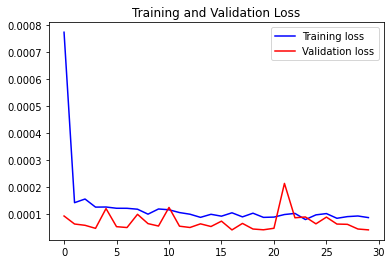

In [26]:
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(len(loss))
#plt.figure()
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
#plt.plot(epochs,history.history['mse'],'y',label='training accuracy')
plt.title("Training and Validation Loss")
plt.legend()
plt.show()
#normaly we would see a slower training loss decline and a higher validation loss at the beginning but it is acceptable

# Evaluation

In [27]:
# compute prediction for test
y_pred = regressor.predict([X_test])

In [28]:
from sklearn.metrics import mean_squared_error

In [29]:
# compute rmse for test
y_pred_inverse = scaler.inverse_transform(np.concatenate([y_pred, data_test[-len(y_pred):,1:]], axis=1))
y_test_inverse = scaler.inverse_transform(data_test.reshape(-1,len(columns)))[rnn_size:]
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))
rmse_score =rmse(y_test_inverse[0:len(y_test_inverse),0], y_pred_inverse[0:len(y_pred_inverse),0])
print("rmse score : ", rmse_score)

rmse score :  2070.7488848233393


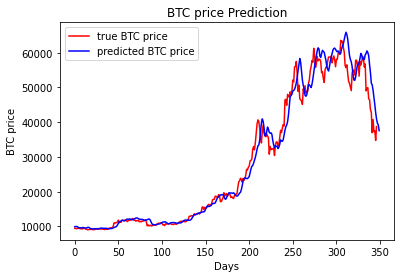

In [30]:
#Graphs for predicted values
plt.plot(y_test_inverse[rnn_size:,0], color = 'red', label = 'true BTC price')
plt.plot(y_pred_inverse[:,0], color = 'blue', label = 'predicted BTC price')
plt.title('BTC price Prediction')
plt.xlabel('Days')
plt.ylabel('BTC price')
plt.legend()
plt.show()

In [31]:
# If you get this far, you can : 
#- Test other neural network models
#- Test other optimizers
#- Compare results between Arima and RNN models
#- Find a way to choose most important variables
#- Implement a trading algorithm

## Testing other optimizers


In [32]:
opti=["SGD","RMSprop","Adam","Adadelta","Adagrad","Adamax","Nadam","Ftrl"]

In [54]:
def LSTM_opt(opt_m):
    regressor = keras.Sequential()
    regressor.add(LSTM(128, input_shape=(rnn_size,len(columns)), 
                      activation='relu', return_sequences=True))
    regressor.add(Dropout(0.2))

    regressor.add(LSTM(64, activation='relu'))
    regressor.add(Dropout(0.2))


    regressor.add(Dense(32, activation='relu'))
    regressor.add(Dropout(0.2))

    regressor.add(Dense(1, activation='relu'))
    regressor.compile(optimizer=opt_m,
    loss='mean_squared_error',metrics=['mean_squared_error'])
    regressor.fit(X_train, y_train, epochs = 30, batch_size =30, validation_data=(X_val,y_val))
    y_pred = regressor.predict([X_test])
    return(y_pred)

In [34]:
rmse_score=[]
for i in opti:
  y_pred=LSTM_opt(i)
  y_pred_inverse = scaler.inverse_transform(np.concatenate([y_pred, data_test[-len(y_pred):,1:]], axis=1))
  rmse_score.append([i,rmse(y_test_inverse[0:len(y_test_inverse),0], y_pred_inverse[0:len(y_pred_inverse),0])])

Epoch 1/30
89/89 [==============================] - 4s 15ms/step - loss: 0.0025 - mean_squared_error: 0.0025 - val_loss: 0.0096 - val_mean_squared_error: 0.0096
Epoch 2/30
89/89 [==============================] - 1s 10ms/step - loss: 0.0023 - mean_squared_error: 0.0023 - val_loss: 0.0092 - val_mean_squared_error: 0.0092
Epoch 3/30
89/89 [==============================] - 1s 10ms/step - loss: 0.0023 - mean_squared_error: 0.0023 - val_loss: 0.0090 - val_mean_squared_error: 0.0090
Epoch 4/30
46/89 [==============>...............] - ETA: 0s - loss: 0.0023 - mean_squared_error: 0.0023

KeyboardInterrupt: ignored

In [ ]:
rmse_score
#best performance is from 'RMSPROP' but adam and adamx are also good and close in performance

[['SGD', 30803.895710962406],
 ['RMSprop', 1707.1857640746923],
 ['Adam', 2223.9763422845704],
 ['Adadelta', 32391.325216164983],
 ['Adagrad', 31048.099375011625],
 ['Adamax', 2309.6249084822243],
 ['Nadam', 3371.1801573843977],
 ['Ftrl', 31967.50968714977]]

## testing other RNN model

for another RNN model i wanted to work with darts but seems like darts methods only work with a specific type (darts.timeseries.timeseries) and to convert pddataframe to such type we need to define classes and it's a bit complex

In [ ]:
print(type(series_sunspot),type(data2)) #<class 'darts.timeseries.TimeSeries'> <class 'pandas.core.series.Series'>

<class 'darts.timeseries.TimeSeries'> <class 'pandas.core.series.Series'>


so i will stick with keras and try using GRU and simpleRNN instead of LSTM, changing the activation method

In [36]:
 from keras.layers.recurrent import GRU

In [37]:
from tensorflow.keras.optimizers import RMSprop

In [38]:
from keras.layers.embeddings import Embedding

In [39]:
step_back = 1

In [55]:
model = Sequential()
# Input layer
model.add(GRU (64, return_sequences = True, 
input_shape = [X_train.shape[1], X_train.shape[2]]))
model.add(Dropout(0.2)) 
# Hidden layer
model.add(GRU(64)) 
model.add(Dropout(0.2))
model.add(Dense(units = 1)) 
#Compile model
model.compile(optimizer='adam',loss='mse')

In [56]:
history=model.fit(X_train, y_train, epochs = 30, batch_size =30, validation_data=(X_val,y_val))

Epoch 1/30
89/89 [==============================] - 7s 19ms/step - loss: 3.8762e-04 - val_loss: 6.1582e-05
Epoch 2/30
89/89 [==============================] - 1s 12ms/step - loss: 4.9647e-05 - val_loss: 4.1871e-05
Epoch 3/30
89/89 [==============================] - 1s 12ms/step - loss: 5.1724e-05 - val_loss: 5.6715e-05
Epoch 4/30
89/89 [==============================] - 1s 14ms/step - loss: 4.1752e-05 - val_loss: 2.0938e-04
Epoch 5/30
89/89 [==============================] - 2s 17ms/step - loss: 4.3788e-05 - val_loss: 5.2485e-05
Epoch 6/30
89/89 [==============================] - 1s 11ms/step - loss: 5.1104e-05 - val_loss: 1.0491e-04
Epoch 7/30
89/89 [==============================] - 1s 11ms/step - loss: 3.3358e-05 - val_loss: 3.0407e-05
Epoch 8/30
89/89 [==============================] - 1s 11ms/step - loss: 3.5985e-05 - val_loss: 4.9060e-05
Epoch 9/30
89/89 [==============================] - 1s 11ms/step - loss: 4.2506e-05 - val_loss: 3.1329e-05
Epoch 10/30
89/89 [==================

In [57]:
def plot_loss (history, model_name):
    plt.figure(figsize = (10, 6))
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Train vs Validation Loss for ' + model_name)
    plt.ylabel('Loss')
    plt.xlabel('epoch')
    plt.legend(['Train loss', 'Validation loss'], loc='upper right')


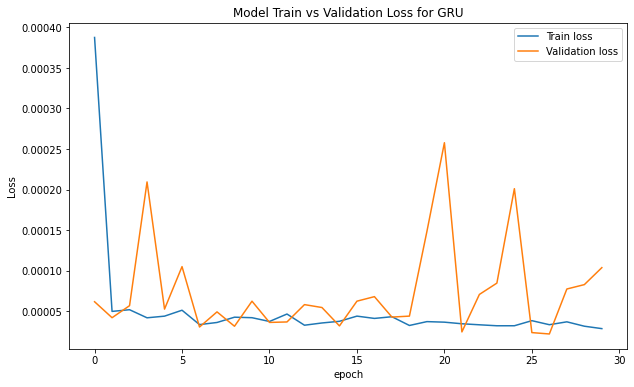

In [58]:
plot_loss (history, 'GRU')
#we see a more classic form of validation loss, it increasing at~19 epoch after a major decrease means that model could have entered an overfitting state

In [59]:
y_pred = model.predict([X_test])

In [60]:
y_pred_inverse = scaler.inverse_transform(np.concatenate([y_pred, data_test[-len(y_pred):,1:]], axis=1))
y_test_inverse = scaler.inverse_transform(data_test.reshape(-1,len(columns)))[rnn_size:]
def rmse(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))
rmse_score =rmse(y_test_inverse[0:len(y_test_inverse),0], y_pred_inverse[0:len(y_pred_inverse),0])
print("rmse score : ", rmse_score)

rmse score :  1983.1868831687525


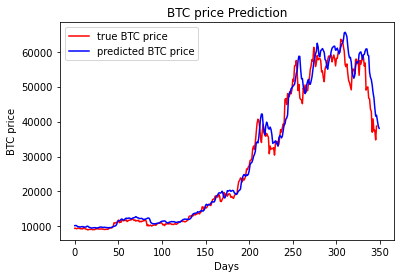

In [46]:
plt.plot(y_test_inverse[rnn_size:,0], color = 'red', label = 'true BTC price')
plt.plot(y_pred_inverse[:,0], color = 'blue', label = 'predicted BTC price')
plt.title('BTC price Prediction')
plt.xlabel('Days')
plt.ylabel('BTC price')
plt.legend()
plt.show()

GRU gives "strangely" better rmse (and price is visibly closer with rmse)
maybe parameters for lstm were badly chosen because it is widly more popular

## finding most important variables

In [ ]:
columns=['market-price',
 'n-transactions-per-block',
 'median-confirmation-time',
 'hash-rate',
 'difficulty',
 'miners-revenue',
 'trade-volume',
 'blocks-size',
 'avg-block-size',
 'transaction-fees',
 'transaction-fees-usd',
 'cost-per-transaction-percent',
 'cost-per-transaction',
 'n-unique-addresses',
 'n-transactions',
 'n-transactions-total',
 'n-transactions-excluding-popular',
 'output-volume',
 'estimated-transaction-volume',
 'estimated-transaction-volume-usd',
 'total-bitcoins',
 'market-cap']
dataset = df[columns]
scaler = MinMaxScaler(feature_range=(0, 1))
dataset = scaler.fit_transform(dataset.values.reshape(-1,len(columns)))
data_train = dataset[:2650]
data_valid = dataset[2650:3180]
data_test = dataset[3180:]
def process_data(data, rnn_size=3, target_id=0, columns_size=len(columns)):
    X = []
    y = []
    for i in range(len(data)-rnn_size):
        X.append(data[i:i+rnn_size,:])
        y.append(data[i+rnn_size,0])
    return np.array(X).astype(np.float32).reshape((-1,rnn_size,columns_size)), np.array(y).astype(np.float32)
X_train, y_train = process_data(data_train)
X_val, y_val = process_data(data_valid)
X_test, y_test = process_data(data_test)

In [ ]:
regressor = keras.Sequential()
regressor.add(LSTM(128, input_shape=(rnn_size,len(columns)), 
                   activation='relu', return_sequences=True))
regressor.add(Dropout(0.2))

regressor.add(LSTM(64, activation='relu'))
regressor.add(Dropout(0.2))


regressor.add(Dense(32, activation='relu'))
regressor.add(Dropout(0.2))

regressor.add(Dense(1, activation='relu'))
opt = tf.keras.optimizers.Adam()
regressor.compile(optimizer='adam',
loss='mean_squared_error',metrics=['mean_squared_error'])
regressor.fit(X_train, y_train, epochs = 30, batch_size =30, validation_data=(X_val,y_val))
y_pred = regressor.predict([X_test])

Epoch 1/30
89/89 [==============================] - 6s 17ms/step - loss: 5.1730e-04 - mean_squared_error: 5.1730e-04 - val_loss: 2.7897e-04 - val_mean_squared_error: 2.7897e-04
Epoch 2/30
89/89 [==============================] - 1s 13ms/step - loss: 2.0857e-04 - mean_squared_error: 2.0857e-04 - val_loss: 4.8174e-04 - val_mean_squared_error: 4.8174e-04
Epoch 3/30
89/89 [==============================] - 1s 14ms/step - loss: 1.6302e-04 - mean_squared_error: 1.6302e-04 - val_loss: 2.9392e-04 - val_mean_squared_error: 2.9392e-04
Epoch 4/30
89/89 [==============================] - 2s 21ms/step - loss: 1.3945e-04 - mean_squared_error: 1.3945e-04 - val_loss: 2.0342e-04 - val_mean_squared_error: 2.0342e-04
Epoch 5/30
89/89 [==============================] - 2s 20ms/step - loss: 1.4605e-04 - mean_squared_error: 1.4605e-04 - val_loss: 4.7515e-04 - val_mean_squared_error: 4.7515e-04
Epoch 6/30
89/89 [==============================] - 2s 21ms/step - loss: 1.1910e-04 - mean_squared_error: 1.1910e-0

In [ ]:
# Find a way to choose most important variables for the LSTM + Dense neural network model

def var_importance(model):
    for i in range(len(columns)):  # iterate over the three features
        new_x = X_test.copy()
        perturbation = np.random.normal(0.0, 0.2, size=new_x.shape[:2])
        new_x[:, :, i] = new_x[:, :, i] + perturbation
        perturbed_out = model.predict(new_x)
        effect = ((y_pred - perturbed_out) * 2).mean() * 0.5
        print(f'Variable {i+1}, perturbation effect: {effect:.4f}')

var_importance(regressor)

# Variable 1 is market-price and variable 2 is market-cap

# For each variable, we'll perturb that variable (and only that variable) by a random normal distribution centered at 0 with scale 0.2 and compute a prediction.
# We'll measure the effect this perturbation has by computing the Root Mean Square difference between the original prediction and the perturbed one.

# so there are two variables that have a relative remarquable perturbation effect: variable6 ('miners-revenue') and variable 19('estimated transaction volume') but does having a big perturbation 
# effect implies helping improve prediction? well apearently no because when testing initial variables as makret-price, miners-revenue,estimated trasaction volume we get 10000 rmse

Variable 1, perturbation effect: -0.0003
Variable 2, perturbation effect: -0.0001
Variable 3, perturbation effect: 0.0000
Variable 4, perturbation effect: -0.0004
Variable 5, perturbation effect: 0.0000
Variable 6, perturbation effect: -0.0013
Variable 7, perturbation effect: -0.0001
Variable 8, perturbation effect: -0.0001
Variable 9, perturbation effect: -0.0002
Variable 10, perturbation effect: 0.0001
Variable 11, perturbation effect: -0.0001
Variable 12, perturbation effect: 0.0000
Variable 13, perturbation effect: -0.0006
Variable 14, perturbation effect: 0.0001
Variable 15, perturbation effect: -0.0001
Variable 16, perturbation effect: 0.0000
Variable 17, perturbation effect: -0.0003
Variable 18, perturbation effect: -0.0000
Variable 19, perturbation effect: -0.0014
Variable 20, perturbation effect: -0.0004
Variable 21, perturbation effect: 0.0000
Variable 22, perturbation effect: 0.0007
